In [127]:
import random
import yfinance as yf
import numpy as np
import matplotlib.pyplot as plt
import ETFs as etfs
import pandas as pd
import plotly.express as px

In [128]:
def simulation_MC(n_months, initial_capitals, price_changes):
    values = []
    values.append(initial_capitals)
    total = [np.sum(initial_capitals)] 
    for _ in range(n_months):
        values_new = []
        for i in range(len(initial_capitals)):  
            if len(price_changes[i]) == 0:
                values_new.append(values[-1][i]) 
                continue
            idx = random.randint(0, len(price_changes[i]) - 1)
            new_value = values[-1][i] * (1 +(price_changes[i][idx]))  
            values_new.append(new_value)
        values.append(values_new)  
        total.append(np.sum(values_new))  
    return total

In [ ]:
def generate_random_allocation(n_assets, total_capital=1):
    proportions = np.random.dirichlet(np.ones(n_assets))  
    allocation = proportions * total_capital  
    return proportions, allocation.tolist()

In [130]:
tickers = etfs.etfs
start_date = "2012-01-01"
end_date = "2025-03-31"
assets = yf.download(tickers, start=start_date, end=end_date)["Close"]

[*********************100%***********************]  33 of 33 completed


In [131]:
assets_resample = assets.resample('ME').last()  
price_changes = []
std_devs = []
ticker_names = []
for ticker in tickers:
    price_change = assets_resample[ticker].pct_change().dropna().values
    if len(price_change) == 0:
        print(f"{ticker} has insufficient data for price change calculations.")
    std_dev = np.std(price_change)
    std_devs.append(std_dev)
    ticker_names.append(ticker)
    price_changes.append(price_change)

ticker_summary = pd.DataFrame({
    'Ticker': ticker_names,
    'Standard Deviation': std_devs
})
# display(ticker_summary) 

In [132]:
def generate_one_allocation(i, total_capital=1):
    for idx, ticker in enumerate(tickers):
        proportions_only = np.zeros(len(tickers))
        proportions_only[i] = 1
        allocations_only = proportions_only * total_capital
        return proportions_only, allocations_only.tolist()

In [133]:
num_simulations = 100000 + len(tickers)
risk_values = []
return_values = []
allocations_list = []
proportions_list = []
risk_special = []
return_special = []
for i in range(num_simulations):
    if i < 33:
        proportions, initial_capitals = generate_one_allocation(i)
    else:
        proportions, initial_capitals = generate_random_allocation(len(tickers))
    total = simulation_MC(n_months = 60, initial_capitals=initial_capitals, price_changes=price_changes)
    # percent_changes = np.diff(total) / total[:-1] * 100
    # portfolio_return = np.mean(percent_changes)
    portfolio_return = (total[-1] - total[0]) / total[0] 
    portfolio_risk = np.std(total) 
    risk_values.append(portfolio_risk)
    return_values.append(portfolio_return)
    proportions_list.append([round(p*100, 3) for p in proportions])
    if i < 33:
        risk_special.append(portfolio_risk)
        return_special.append(portfolio_return)

# Check on individual asset

In [ ]:
n_months = 60
initial_capital = 100
inflation_factor = 1.066 ** (n_months / 12)
risk_values_single = []
return_values_single = []
risk_single = []
return_single = []
for i, ticker in enumerate(tickers):
    proportions_only = np.zeros(len(tickers))
    proportions_only[i] = 1
    allocations_only = proportions_only * initial_capital
    absolute_losses = 0
    cpi_adjusted_losses = 0
    gain_50 = 0
    gain_100 = 0
    gain_200 = 0

    for _ in range(num_simulations):
        total_value = simulation_MC(
            n_months=n_months,
            initial_capitals=allocations_only,
            price_changes=price_changes
        )
        percent_changes_single = np.diff(total_value) / total_value[:-1] * 100
        portfolio_return_single = np.mean(percent_changes_single)
        portfolio_risk_single = np.std(total_value)
        risk_values_single.append(portfolio_risk_single)
        return_values_single.append(portfolio_return_single)
        
        final = total_value[n_months]
        real_gain = final / inflation_factor

        if final < initial_capital:
            absolute_losses += 1
        if real_gain < initial_capital:
            cpi_adjusted_losses += 1
        if real_gain > initial_capital * 1.5:
            gain_50 += 1
        if real_gain > initial_capital * 2:
            gain_100 += 1
        if real_gain > initial_capital * 3:
            gain_200 += 1
    risk_single.append(np.mean(risk_values_single))
    return_single.append(np.mean(return_values_single))
    
    print(f"{'--------' + ticker + '--------':<40}{'Percent':>11}")
    print(f"{'Money lost (absolute USD)':<40} {absolute_losses / num_simulations * 100:>9.1f}%")
    print(f"{'Money lost (inflation-adjusted USD)':<40} {cpi_adjusted_losses / num_simulations * 100:>9.1f}%")
    print(f"{'Inflation-adjusted gain >50%':<40} {gain_50 / num_simulations * 100:>9.1f}%")
    print(f"{'Inflation-adjusted gain >100%':<40} {gain_100 / num_simulations * 100:>9.1f}%")
    print(f"{'Inflation-adjusted gain >200%':<40} {gain_200 / num_simulations * 100:>9.1f}%\n")


In [ ]:

plt.figure(figsize=(10, 6))
plt.scatter(risk_single, return_single, color='b', marker='x', alpha=0.5)
for i in range(len(ticker_names)):
    plt.text(risk_single[i] + 0.001, return_single[i] + 0.001, ticker_names[i], fontsize=9)
plt.xlabel("Risk")
plt.ylabel("Return")
plt.title(f"Risk vs Return for {num_simulations} Simulations")
plt.grid()
plt.show()
risk_return_single_df = pd.DataFrame({
    'Ticker': ticker_names,
    'Return_average': return_single,
    'Std_average': risk_single,
})
display(risk_return_single_df)


In [136]:

# df = pd.DataFrame({
#     'Risk': risk_single,
#     'Return': return_single,
#     'Ticker': ticker_names
# })

# fig = px.scatter(df, x='Risk', y='Return', text='Ticker', hover_name='Ticker',
#                  title=f"Risk vs Return for {num_simulations} Simulations")
# fig.update_traces(textposition='top center')
# fig.show()

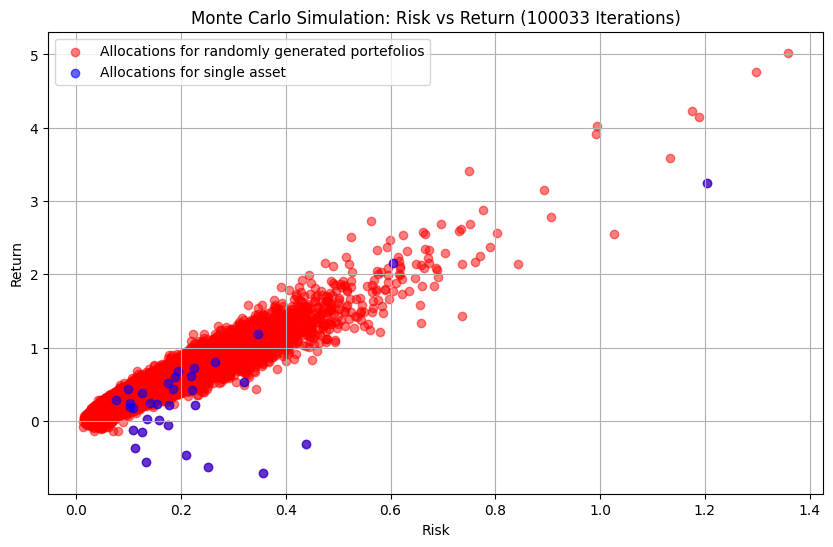

,Return,Std,Proportions,Proportions_etfs
0,1.185601,0.347846,"[100.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","{'SPY': '100.00%', 'ASHR.L': '0.00%', 'VPL': '..."
1,0.171723,0.108316,"[0.0, 100.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","{'SPY': '0.00%', 'ASHR.L': '100.00%', 'VPL': '..."
2,0.281096,0.076840,"[0.0, 0.0, 100.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","{'SPY': '0.00%', 'ASHR.L': '0.00%', 'VPL': '10..."
3,-0.559600,0.134126,"[0.0, 0.0, 0.0, 100.0, 0.0, 0.0, 0.0, 0.0, 0.0...","{'SPY': '0.00%', 'ASHR.L': '0.00%', 'VPL': '0...."
4,0.798863,0.265487,"[0.0, 0.0, 0.0, 0.0, 100.0, 0.0, 0.0, 0.0, 0.0...","{'SPY': '0.00%', 'ASHR.L': '0.00%', 'VPL': '0...."
...,...,...,...,...
100028,0.344364,0.107919,"[0.937, 0.36, 3.04, 6.121, 0.246, 10.466, 2.89...","{'SPY': '0.94%', 'ASHR.L': '0.36%', 'VPL': '3...."
100029,0.601412,0.197917,"[0.686, 0.301, 1.224, 2.457, 4.583, 4.964, 3.1...","{'SPY': '0.69%', 'ASHR.L': '0.30%', 'VPL': '1...."
100030,0.826246,0.230275,"[0.775, 8.07, 3.735, 1.061, 2.822, 2.247, 1.73...","{'SPY': '0.78%', 'ASHR.L': '8.07%', 'VPL': '3...."
100031,0.581730,0.192685,"[0.509, 2.752, 2.319, 4.609, 6.87, 4.501, 1.98...","{'SPY': '0.51%', 'ASHR.L': '2.75%', 'VPL': '2...."


In [137]:
plt.figure(figsize=(10, 6))
plt.scatter(risk_values, return_values, color='r',label="Allocations for randomly generated portefolios",  marker='o', alpha=0.5)
plt.scatter(risk_special, return_special, color='blue', label='Allocations for single asset', alpha=0.6)

# plt.scatter(risk_values_single, return_values_single, color='b', marker='x', alpha=0.5)
plt.xlabel("Risk")
plt.ylabel("Return")
plt.title(f"Monte Carlo Simulation: Risk vs Return ({num_simulations} Iterations)")
plt.legend()
plt.grid()
plt.show()

risk_return_df = pd.DataFrame({
    'Return': return_values ,
    'Std': risk_values,
    'Proportions': proportions_list ,
})

risk_return_df['Proportions_etfs'] = [
    {
        ticker: f"{weight:.2f}%"
        for ticker, weight in zip(tickers, p)
    }
    for p in proportions_list
]

display(risk_return_df)

In [ ]:
new_df = risk_return_df[['Return', 'Std', 'Proportions_etfs']].copy()
def get_top_5_etfs(etf_dict):
    try:
        # Already a dictionary
        etfs_cleaned = {
            k: float(str(v).strip('%'))
            for k, v in etf_dict.items()
        }
        # Sort descending
        sorted_etfs = sorted(etfs_cleaned.items(), key=lambda x: -x[1])
        # Top 5
        top_5 = sorted_etfs[:5]
        # Format back to string
        return ', '.join([f"{k}: {v:.2f}%" for k, v in top_5])
    except Exception as e:
        print(f"Error processing row: {etf_dict} — error: {e}")
        return ""
new_df['Top_5_ETFs'] = new_df['Proportions_etfs'].apply(get_top_5_etfs)
new_df = new_df.drop(columns=['Proportions_etfs'])
new_df = new_df.sort_values(by='Return', ascending=False).reset_index(drop=True)
new_df = new_df.rename(columns={'Std': 'Risk'})

new_df['Return'] = new_df['Return'].round(3)
new_df['Risk'] = new_df['Risk'].round(3)


display(new_df)
new_df.to_csv('check.csv', index=False)

,Return,Risk,Top_5_ETFs
0,5.024,1.358,"BCHN.L: 16.13%, VNQ: 10.71%, DBO: 7.20%, AIEQ:..."
1,4.757,1.297,"BCHN.L: 15.24%, GLD: 14.77%, EWW: 9.88%, EDEN:..."
2,4.229,1.175,"TLT: 9.84%, EWU: 8.57%, SEMI.AS: 8.49%, GLD: 8..."
3,4.141,1.188,"EWG: 14.85%, BCHN.L: 13.14%, IDUP.L: 10.17%, K..."
4,4.023,0.995,"BCHN.L: 10.29%, GLD: 8.92%, EMXC: 8.50%, DBO: ..."
...,...,...,...
100028,-0.364,0.113,"EDEN: 100.00%, SPY: 0.00%, ASHR.L: 0.00%, VPL:..."
100029,-0.463,0.210,"AIEQ: 100.00%, SPY: 0.00%, ASHR.L: 0.00%, VPL:..."
100030,-0.560,0.134,"INDA: 100.00%, SPY: 0.00%, ASHR.L: 0.00%, VPL:..."
100031,-0.632,0.251,"DBO: 100.00%, SPY: 0.00%, ASHR.L: 0.00%, VPL: ..."


In [139]:
def format_named_percentages(proportions, tickers, top_n=5):
    top_indices = sorted(
        range(len(proportions)),
        key=lambda i: proportions[i],
        reverse=True
    )[:top_n]
    return '<br>' + '<br>'.join(
        f'{tickers[i]}: {proportions[i]:.1f}%' for i in top_indices
    )


risk_return_df['Proportions_str'] = risk_return_df['Proportions'].apply(
    lambda x: format_named_percentages(x, tickers, top_n=5)
)

fig = px.scatter(
    risk_return_df,
    x='Std',
    y='Return',
    title=f"Monte Carlo Simulation: Risk vs Return ({num_simulations} Iterations)",
    opacity=0.5,
)

fig.update_traces(
    marker=dict(size=7),
    hovertemplate="<br>".join([
        "Risk: %{x:.4f}",
        "Return: %{y:.4f}",
        "%{customdata[0]}"
    ]),
    customdata=risk_return_df[['Proportions_str']].values
)

fig.update_layout(
    xaxis_title="Risk",
    yaxis_title="Return",
    template="plotly_white"
)

fig.show()



In [ ]:
def pareto_front(risk_return_df):
    sorted_df = risk_return_df.sort_values(by='Std', ascending=True)
    
    points_sets = []
    highest_return_so_far = -float('inf') 
    
    for _, row in sorted_df.iterrows():
        portfolio_return = row['Return']        
        if portfolio_return > highest_return_so_far:
            points_sets.append(row)
            highest_return_so_far = portfolio_return  
    
    points_sets_df = pd.DataFrame(points_sets)
    
    return points_sets_df

pareto_front_df = pareto_front(risk_return_df)


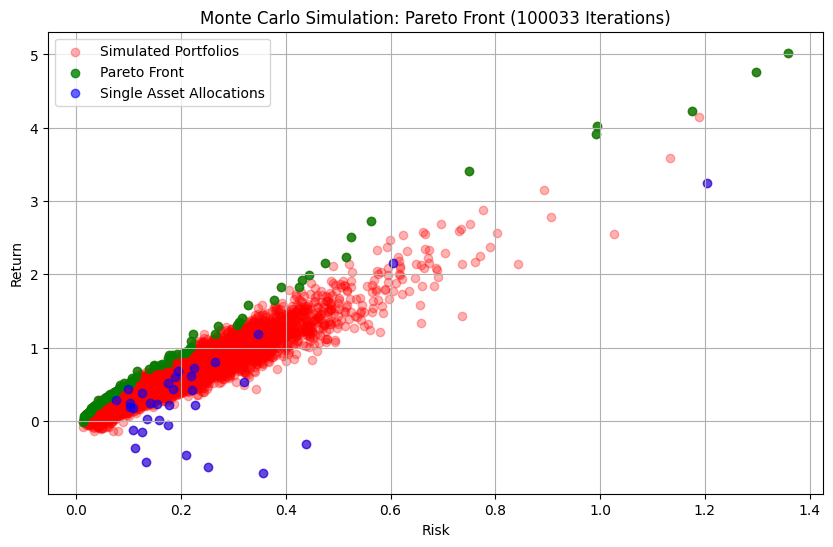

In [141]:
plt.figure(figsize=(10, 6))
plt.scatter(risk_return_df['Std'], risk_return_df['Return'], color='r', marker='o', alpha=0.3, label='Simulated Portfolios')
plt.scatter(pareto_front_df['Std'], pareto_front_df['Return'], color='g', marker='o', label='Pareto Front', alpha=0.8)
plt.scatter(risk_special, return_special, color='blue', label='Single Asset Allocations', alpha=0.6)
plt.xlabel("Risk")
plt.ylabel("Return")
plt.title(f"Monte Carlo Simulation: Pareto Front ({num_simulations} Iterations)")
plt.legend(loc='upper left')
plt.grid()
plt.show()

In [ ]:
risk_return_df['Proportions_str'] = risk_return_df['Proportions'].apply(
    lambda x: format_named_percentages(x, tickers, top_n=5)
)
simulated_df = risk_return_df.copy()
simulated_df['Group'] = 'Simulated Portfolios'

pareto_df = pareto_front_df.copy()
pareto_df['Group'] = 'Pareto Front'
pareto_df['Proportions_str'] = ''  

special_df = pd.DataFrame({
    'Std': risk_special,
    'Return': return_special,
    'Group': ['Single Asset Allocations'] * len(risk_special),
    'Proportions_str': [''] * len(risk_special)  
})

combined_df = pd.concat([simulated_df, pareto_df, special_df], ignore_index=True)

risk_return_plot = px.scatter(
    combined_df,
    x='Std',
    y='Return',
    color='Group',
    hover_data=['Proportions_str'],
    title=f"Monte Carlo Simulation: Pareto Front ({num_simulations} Iterations)",
    labels={'Std': 'Risk', 'Return': 'Return'},
    opacity=0.7
)

risk_return_plot.update_layout(
    legend=dict(title=''),
    width=800,
    height=600,
    template='plotly_white'
)

risk_return_plot.show()


In [ ]:
# display(pareto_front_df)

proportions_df = pareto_front_df['Proportions'].apply(pd.Series)
proportions_df.columns = tickers  
pareto_expanded_df = pd.concat([pareto_front_df.drop(columns=['Proportions']), proportions_df], axis=1)
pareto_expanded_df = pareto_expanded_df.drop(columns = ['Proportions_etfs'])

pareto_expanded_df = pareto_expanded_df.drop(columns = ['Proportions_str'])
# portfolio = pd.DataFrame(pareto_front_df.iloc[0]['Proportions'], index=tickers, columns=['Proportions'])
# display(portfolio)
# display(pareto_expanded_df)  # or print(pareto_expanded_df)

pareto_expanded_df.to_csv("weights_suggestion.csv", index=False)

top_assets_list = []

for idx, row in pareto_expanded_df.iterrows():
    asset_weights = row[tickers]
    top_assets = asset_weights.sort_values(ascending=False).head(5)
    top_assets_list.append({
        'Portfolio_Index': idx,
        'Top_Assets': list(top_assets.index),
        'Weights': [float(w) for w in top_assets.values],
        'Return': row['Return'].round(4),
        'Risk': row['Std'].round(4)
    })

top_assets_df = pd.DataFrame(top_assets_list)
display(top_assets_df)


PermissionError: [Errno 13] Permission denied: 'top_assets_report.csv'

In [ ]:
import seaborn as sns
choosen_portfolio_index = [1323,	51001]
chosen_portfolios = top_assets_df[top_assets_df['Portfolio_Index'].isin(choosen_portfolio_index)]

for index, row in chosen_portfolios.iterrows():
    ticker_top = row['Top_Assets']
    portfolio_return = row['Return']
    portfolio_risk = row['Risk']

    assets = yf.download(ticker_top, start=start_date, end=end_date)
    close_prices = assets['Close']

    # display(close_prices)

    correlation_matrix = close_prices.corr()
    mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))


    plt.figure(figsize=(5, 5))
    sns.heatmap(
        correlation_matrix, 
        mask=mask, 
        annot=True, 
        cmap='coolwarm', 
        vmin=-1, 
        vmax=1
    )
    plt.title(f"Correlation Heatmap\nReturn = {portfolio_return:.2%}, Risk = {portfolio_risk:.2%}")
    plt.show() 

[*********************100%***********************]  5 of 5 completed
[*********************100%***********************]  5 of 5 completed
[*********************100%***********************]  5 of 5 completed
[*********************100%***********************]  5 of 5 completed


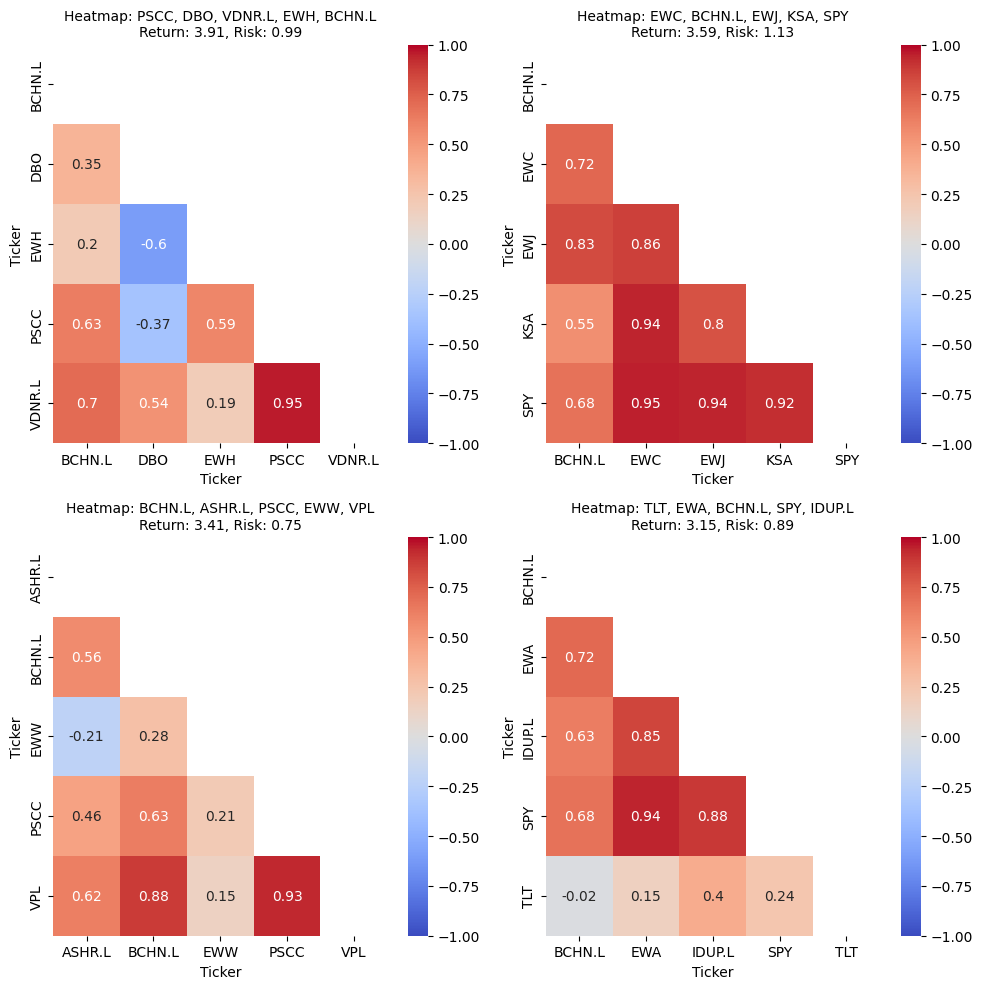

In [ ]:
etf_rows = [
    ["PSCC", "DBO", "VDNR.L", "EWH", "BCHN.L"],
    ["EWC", "BCHN.L", "EWJ", "KSA", "SPY"],
    ["BCHN.L", "ASHR.L", "PSCC", "EWW", "VPL"],
    # ["EWA", "SPY", "ASHR.L", "VPL", "INDA"],
    ["TLT", "EWA", "BCHN.L", "SPY", "IDUP.L"]
]

returns_and_risks = [
    (3.908527254690221, 0.9927230721332533),
    (3.593712436822896, 1.1324938370582163),
    (3.4081475823235223, 0.7502721324384986),
    # (3.248448115467782, 1.2035871361329138),
    (3.1527193219944314, 0.8920759721827699)
]

num_plots = len(etf_rows)
num_cols = 2
num_rows = (num_plots + num_cols - 1) // num_cols

fig, axes = plt.subplots(num_rows, num_cols, figsize=(5*num_cols, 5*num_rows))
axes = axes.flatten()

for i, (row, (portfolio_return, portfolio_risk)) in enumerate(zip(etf_rows, returns_and_risks)):
    ticker_top = row
    assets = yf.download(ticker_top, start=start_date, end=end_date)
    close_prices = assets['Close']

    correlation_matrix = close_prices.corr()
    mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))

    sns.heatmap(
        correlation_matrix,
        mask=mask,
        annot=True,
        cmap='coolwarm',
        vmin=-1,
        vmax=1,
        ax=axes[i]
    )
    axes[i].set_title(
        f"Heatmap: {', '.join(ticker_top)}\nReturn: {portfolio_return:.2f}, Risk: {portfolio_risk:.2f}",
        fontsize=10
    )

for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()
